In [7]:
"""
Classification Case Study: Diabetes Prediction
=====================================================
Demonstrating various classification algorithms:
1. Logistic Regression
2. Decision Tree
3. K-Nearest Neighbors (KNN)
4. Naive Bayes Classifier - Gaussian or Multinomial 
5. Instance-Based Learning
6. Ensemble Methods - Random Forest
7. Ensemble Methods - XG Boost

Dataset: Diabetes Prediction(Real Dataset)
Download from: https://www.kaggle.com/datasets/marshalpatel3558/diabetes-prediction-dataset-legit-dataset
"""

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    confusion_matrix, classification_report, roc_curve, roc_auc_score,
    precision_recall_curve, average_precision_score, matthews_corrcoef
)
import warnings
warnings.filterwarnings('ignore')

# Set style for visualizations
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("husl")


In [8]:
#### =============================================================================
# SECTION 1: DATA LOADING AND PREPARATION
# =============================================================================

import pandas as pd
df = pd.read_csv(r"C:\Users\91956\Desktop\Dataset of Diabetes .csv")
    
def explore_data(df):
    """
    Perform exploratory data analysis on the dataset.
    """
    print("\n" + "="*60)
    print("EXPLORATORY DATA ANALYSIS")
    print("="*60)

    print(f"\nDataset Shape: {df.shape}")
    print(f"Total Customers: {len(df):,}")

    print("\nColumn Names:")
    print(df.columns.tolist())

    print("\nData Types:")
    print(df.dtypes)

    print("\nSample of Data:")
    print(df.head())

    print("\nMissing Values:")
    print(df.isnull().sum()[df.isnull().sum() > 0])

    print("\nCLASS Distribution:")
    print(df['CLASS'].value_counts())
    print(f"\nCLASS: {df['CLASS'].value_counts(normalize=True).get('Yes', df['CLASS'].value_counts(normalize=True).get(1, 0)):.2%}")

    return df


In [9]:
df = explore_data(df)


EXPLORATORY DATA ANALYSIS

Dataset Shape: (1000, 14)
Total Customers: 1,000

Column Names:
['ID', 'No_Pation', 'Gender', 'AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI', 'CLASS']

Data Types:
ID             int64
No_Pation      int64
Gender        object
AGE            int64
Urea         float64
Cr             int64
HbA1c        float64
Chol         float64
TG           float64
HDL          float64
LDL          float64
VLDL         float64
BMI          float64
CLASS         object
dtype: object

Sample of Data:
    ID  No_Pation Gender  AGE  Urea  Cr  HbA1c  Chol   TG  HDL  LDL  VLDL  \
0  502      17975      F   50   4.7  46    4.9   4.2  0.9  2.4  1.4   0.5   
1  735      34221      M   26   4.5  62    4.9   3.7  1.4  1.1  2.1   0.6   
2  420      47975      F   50   4.7  46    4.9   4.2  0.9  2.4  1.4   0.5   
3  680      87656      F   50   4.7  46    4.9   4.2  0.9  2.4  1.4   0.5   
4  504      34223      M   33   7.1  46    4.9   4.9  1.0  0.8  2.0   0.4

In [10]:
# Generating EDA Report

sns.set(style="whitegrid")
plt.rcParams['figure.figsize'] = (8,5)

from ydata_profiling import ProfileReport

profile = ProfileReport(df, title="EDA Report")
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 217.58it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### EDA Analysis
#### 1. Dataset is clean (NO missing values).
#### 2. Target variable is highly imbalanced. Duplicate lebels are available. Clean target labels first and then select best model as per F1 Score instead of Accuracy.
#### 3. Some inconsistent categorical values.
#### 4. High multicollinearity observed among lipid variables.
#### 5. HbA1c and BMI are likely strongest predictors.

### Correlation Analysis
#### 1. Strong positive linear associations among lipid-related variables (Chol, LDL, TG, and VLDL), suggesting shared variance and potential multicollinearity (high Pearson’s r values).
#### 2. Urea and Creatinine demonstrate a strong positive correlation.
#### 3. Moderate positive correlations are observed between HbA1c, BMI, and Age, indicating a linear association with glycemic control and metabolic risk.
#### 4. The potential multicollinearity may impact linear models but is less problematic for tree-based models. Non-parametric ensemble models (e.g., Random Forest) remain robust to such correlations than parametric models such as Logistic Regression.


In [11]:
# =============================================================================
# SECTION 2: DATA PRE-PROCESSING
# =============================================================================
def preprocess_diabetes_prediction(df):
    """
    Preprocess the Diabetes Prediction dataset.
    """
    print("\n" + "="*60)
    print("DATA PREPROCESSING")
    print("="*60)

    df_processed = df.copy()

    # Drop ID (not useful for prediction)
    if 'ID' in df_processed.columns:
        df_processed = df_processed.drop('ID', axis=1)
        print("Dropped ID column")

    # Drop No_Pation (not useful for prediction)
    if 'No_Pation' in df_processed.columns:
        df_processed = df_processed.drop('No_Pation', axis=1)
        print("Dropped No_Pation column")
    # Fix CLASS
    df['CLASS'] = df['CLASS'].str.strip()

    # Encode categorical variables
    df = pd.get_dummies(df, columns=['Gender'], drop_first=True)
    
    # Convert CLASS to binary
    if df_processed['CLASS'].dtype == 'object':
        df_processed['CLASS'] = (df_processed['CLASS'].isin(['Y', 'P']).astype(int))
        print("Converted CLASS to binary (Y=1, P=1, N=0)")

    # Encode categorical variables
    label_encoders = {}
    categorical_cols = df_processed.select_dtypes(include=['object']).columns

    print(f"\nEncoding {len(categorical_cols)} categorical columns:")
    for col in categorical_cols:
        le = LabelEncoder()
        df_processed[col] = le.fit_transform(df_processed[col].astype(str))
        label_encoders[col] = le
        print(f"  - {col}: {len(le.classes_)} unique values")

    # Check for any remaining missing values
    if df_processed.isnull().sum().sum() > 0:
        print("\nDropping rows with remaining missing values...")
        df_processed = df_processed.dropna()

    print(f"\nFinal dataset shape: {df_processed.shape}")

    print("\nSample of processed data:")
    print(df_processed.head())

    return df_processed, label_encoders

In [12]:
df_processed, label_encoders = preprocess_diabetes_prediction(df)


DATA PREPROCESSING
Dropped ID column
Dropped No_Pation column
Converted CLASS to binary (Y=1, P=1, N=0)

Encoding 1 categorical columns:
  - Gender: 3 unique values

Final dataset shape: (1000, 12)

Sample of processed data:
   Gender  AGE  Urea  Cr  HbA1c  Chol   TG  HDL  LDL  VLDL   BMI  CLASS
0       0   50   4.7  46    4.9   4.2  0.9  2.4  1.4   0.5  24.0      0
1       1   26   4.5  62    4.9   3.7  1.4  1.1  2.1   0.6  23.0      0
2       0   50   4.7  46    4.9   4.2  0.9  2.4  1.4   0.5  24.0      0
3       0   50   4.7  46    4.9   4.2  0.9  2.4  1.4   0.5  24.0      0
4       1   33   7.1  46    4.9   4.9  1.0  0.8  2.0   0.4  21.0      0


In [13]:
# =============================================================================
# SECTION 3: DATA SPLIT AND FEATURE SCALING
# =============================================================================
def prepare_data_splits(df_processed, test_size=0.2, random_state=42):
    """
    Split data into training and testing sets.
    """
    X = df_processed.drop('CLASS', axis=1)
    y = df_processed['CLASS']

    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_size, random_state=random_state, stratify=y
    )

    # Scale features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    print(f"\nTraining set: {len(X_train):,} samples")
    print(f"Test set: {len(X_test):,} samples")
    print(f"Features: {X_train.shape[1]}")

    print("\nScaled sample (first 5 rows):")
    print(X_train_scaled[:5])

    return X_train, X_test, y_train, y_test, X_train_scaled, X_test_scaled, scaler

In [14]:
X_train, X_test, y_train, y_test, X_train_scaled, X_test_scaled, scaler = \
    prepare_data_splits(df_processed)


Training set: 800 samples
Test set: 200 samples
Features: 11

Scaled sample (first 5 rows):
[[-1.16912955  0.30816269 -1.07254073 -0.79444699  0.77398748  0.70118417
  -0.2397549  -0.163003   -0.73049857 -0.26788052 -0.50661948]
 [ 0.8553372   0.76092698  0.59534401 -0.65709966  0.30031093  0.77720565
   0.72902167 -0.58629578  0.94759028 -0.37054132  0.09944812]
 [-1.16912955 -0.48417481 -0.15917528 -0.14204718 -0.8444074  -0.05903068
  -0.65494486 -0.72739338  1.12423121 -0.06255892 -0.91066454]
 [ 0.8553372  -0.25779267  0.1982286   0.11547906  1.01082576 -0.74322405
  -0.79334152 -0.163003   -0.28889624 -0.37054132  1.43279683]
 [ 0.8553372   0.30816269 -0.63571378 -0.00469985  0.57662225  0.5491412
   0.17543506 -0.44519819  0.94759028 -0.21655012 -0.10257442]]


In [15]:
feature_names = X_train.columns.tolist()

 # Store all predictions and probabilities
all_predictions = {}
all_probabilities = {}
all_metrics = {}

In [16]:
# =============================================================================
# SECTION 2: MODEL IMPLEMENTATIONS
# =============================================================================


In [17]:
def train_logistic_regression(X_train, y_train, X_test, y_test):
    """
    Train and evaluate Logistic Regression model.
    """
    print("\n" + "="*60)
    print("LOGISTIC REGRESSION")
    print("="*60)

    # Model with regularization tuning
    lr = LogisticRegression(random_state=42, max_iter=1000, C=0.5)
    lr.fit(X_train, y_train)

    # Predictions
    y_pred = lr.predict(X_test)
    y_prob = lr.predict_proba(X_test)[:, 1]

    # Evaluation
    print(f"\nAccuracy: {accuracy_score(y_test, y_pred):.4f}")
    print(f"Precision: {precision_score(y_test, y_pred):.4f}")
    print(f"Recall: {recall_score(y_test, y_pred):.4f}")
    print(f"F1 Score: {f1_score(y_test, y_pred):.4f}")
    print(f"AUC Score: {roc_auc_score(y_test, y_pred):.4f}")
    print(f"MCC Score: {matthews_corrcoef(y_test, y_pred):.4f}")

    # Feature importance (coefficients)
    if hasattr(X_train, 'columns'):
        print("\nTop 5 Feature Coefficients (by absolute value):")
        feature_importance = pd.DataFrame({
            'feature': X_train.columns,
            'coefficient': lr.coef_[0]
        }).sort_values('coefficient', key=abs, ascending=False)
        print(feature_importance.head())

    return lr, y_pred, y_prob


In [18]:
lr_model, lr_pred, lr_prob = train_logistic_regression(X_train_scaled, y_train, X_test_scaled, y_test)
all_predictions['Logistic Regression'] = lr_pred
all_probabilities['Logistic Regression'] = lr_prob
all_metrics['Logistic Regression'] = {
    'Accuracy': accuracy_score(y_test, lr_pred),
    'Precision': precision_score(y_test, lr_pred),
    'Recall': recall_score(y_test, lr_pred),
    'F1 Score': f1_score(y_test, lr_pred),
    'AUC Score': roc_auc_score(y_test, lr_prob),
    'MCC Score': matthews_corrcoef(y_test, lr_pred)
}


LOGISTIC REGRESSION

Accuracy: 0.9700
Precision: 0.9779
Recall: 0.9888
F1 Score: 0.9833
AUC Score: 0.8992
MCC Score: 0.8347


In [19]:
def train_decision_tree(X_train, y_train, X_test, y_test):
    print("\n" + "="*60)
    print("DECISION TREE")
    print("="*60)

    from sklearn.tree import DecisionTreeClassifier
    from sklearn.metrics import (
        accuracy_score, precision_score, recall_score,
        f1_score, roc_auc_score, matthews_corrcoef
    )

    dt = DecisionTreeClassifier(
        max_depth=10,
        min_samples_leaf=5,
        criterion='gini',
        random_state=42,
        class_weight='balanced'
    )

    dt.fit(X_train, y_train)

    y_pred = dt.predict(X_test)
    y_prob = dt.predict_proba(X_test)[:, 1]

    print(f"\nAccuracy: {accuracy_score(y_test, y_pred):.4f}")
    print(f"Precision: {precision_score(y_test, y_pred):.4f}")
    print(f"Recall: {recall_score(y_test, y_pred):.4f}")
    print(f"F1 Score: {f1_score(y_test, y_pred):.4f}")
    print(f"AUC Score: {roc_auc_score(y_test, y_prob):.4f}")
    print(f"MCC Score: {matthews_corrcoef(y_test, y_pred):.4f}")

    if hasattr(X_train, 'columns'):
        feature_importance = pd.DataFrame({
            'feature': X_train.columns,
            'importance': dt.feature_importances_
        }).sort_values('importance', ascending=False)

        print("\nTop 5 Feature Importance:")
        print(feature_importance.head())

    return dt, y_pred, y_prob


In [20]:
dt_model, dt_pred, dt_prob = train_decision_tree(X_train, y_train, X_test, y_test)
all_predictions['Decision Tree'] = dt_pred
all_probabilities['Decision Tree'] = dt_prob
all_metrics['Decision Tree'] = {
        'Accuracy': accuracy_score(y_test, dt_pred),
        'Precision': precision_score(y_test, dt_pred),
        'Recall': recall_score(y_test, dt_pred),
        'F1 Score': f1_score(y_test, dt_pred),
        'AUC Score': roc_auc_score(y_test, dt_prob),
        'MCC Score': matthews_corrcoef(y_test, dt_pred)
    }



DECISION TREE

Accuracy: 0.9900
Precision: 1.0000
Recall: 0.9888
F1 Score: 0.9944
AUC Score: 1.0000
MCC Score: 0.9502

Top 5 Feature Importance:
   feature  importance
4    HbA1c    0.831823
10     BMI    0.055831
6       TG    0.035093
9     VLDL    0.026861
1      AGE    0.025332


In [21]:
def train_knn(X_train_scaled, y_train, X_test_scaled, y_test):
    """
    Train and evaluate K-Nearest Neighbors model.
    """
    print("\n" + "="*60)
    print("K-NEAREST NEIGHBORS (KNN)")
    print("="*60)

    # Find optimal K (odd numbers from 3 to 29 to avoid ties)
    k_range = range(3, 30, 2)
    cv_scores = []

    print("\nSearching for optimal K...")
    for k in k_range:
        knn = KNeighborsClassifier(n_neighbors=k, weights='distance')
        scores = cross_val_score(knn, X_train_scaled, y_train, cv=5, scoring='f1')
        cv_scores.append(scores.mean())

    best_k = list(k_range)[np.argmax(cv_scores)]
    print(f"Optimal K: {best_k}")

    # Train with best K
    knn = KNeighborsClassifier(n_neighbors=best_k, weights='distance')
    knn.fit(X_train_scaled, y_train)

    # Predictions
    y_pred = knn.predict(X_test_scaled)
    y_prob = knn.predict_proba(X_test_scaled)[:, 1]

    # Evaluation
    print(f"\nAccuracy: {accuracy_score(y_test, y_pred):.4f}")
    print(f"Precision: {precision_score(y_test, y_pred):.4f}")
    print(f"Recall: {recall_score(y_test, y_pred):.4f}")
    print(f"F1 Score: {f1_score(y_test, y_pred):.4f}")
    print(f"AUC Score: {roc_auc_score(y_test, y_pred):.4f}")
    print(f"MCC Score: {matthews_corrcoef(y_test, y_pred):.4f}")

    return knn, y_pred, y_prob, k_range, cv_scores

In [22]:
    knn_model, knn_pred, knn_prob, k_range, cv_scores = train_knn(X_train_scaled, y_train, X_test_scaled, y_test)
    all_predictions['KNN'] = knn_pred
    all_probabilities['KNN'] = knn_prob
    all_metrics['KNN'] = {
        'Accuracy': accuracy_score(y_test, knn_pred),
        'Precision': precision_score(y_test, knn_pred),
        'Recall': recall_score(y_test, knn_pred),
        'F1 Score': f1_score(y_test, knn_pred),
        'AUC Score': roc_auc_score(y_test, knn_prob),
        'MCC Score': matthews_corrcoef(y_test, knn_pred)
    }


K-NEAREST NEIGHBORS (KNN)

Searching for optimal K...
Optimal K: 7

Accuracy: 0.9450
Precision: 0.9565
Recall: 0.9832
F1 Score: 0.9697
AUC Score: 0.8011
MCC Score: 0.6806


In [23]:
from sklearn.preprocessing import MinMaxScaler

minmax = MinMaxScaler()
X_train_nonneg = minmax.fit_transform(X_train)
X_test_nonneg = minmax.transform(X_test)

def train_gaussian_nb(X_train, y_train, X_test, y_test):

    """
    Train and evaluate Naive Bayes.
    """
    print("\n" + "="*60)
    print("NAIVE BAYES")
    print("="*60)
    
    gnb = GaussianNB()

    cv_f1 = cross_val_score(
        gnb, X_train, y_train,
        cv=5, scoring='f1'
    ).mean()

    gnb.fit(X_train, y_train)

    y_pred = gnb.predict(X_test)
    y_prob = gnb.predict_proba(X_test)[:, 1]

    metrics = {
        'CV_F1': cv_f1,
        'Accuracy': accuracy_score(y_test, y_pred),
        'Precision': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1 Score': f1_score(y_test, y_pred),
        'AUC Score': roc_auc_score(y_test, y_prob),
        'MCC Score': matthews_corrcoef(y_test, y_pred)
    }

    return gnb, y_pred, y_prob, metrics

def train_multinomial_nb(X_train, y_train, X_test, y_test):
    mnb = MultinomialNB(alpha=1.0)

    cv_f1 = cross_val_score(
        mnb, X_train, y_train,
        cv=5, scoring='f1'
    ).mean()

    mnb.fit(X_train, y_train)

    y_pred = mnb.predict(X_test)
    y_prob = mnb.predict_proba(X_test)[:, 1]

    metrics = {
        'CV_F1': cv_f1,
        'Accuracy': accuracy_score(y_test, y_pred),
        'Precision': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1 Score': f1_score(y_test, y_pred),
        'AUC Score': roc_auc_score(y_test, y_prob),
        'MCC Score': matthews_corrcoef(y_test, y_pred)
    }

    return mnb, y_pred, y_prob, metrics

gnb_model, gnb_pred, gnb_prob, gnb_metrics = train_gaussian_nb(
    X_train_scaled, y_train, X_test_scaled, y_test
)

mnb_model, mnb_pred, mnb_prob, mnb_metrics = train_multinomial_nb(
    X_train_nonneg, y_train, X_test_nonneg, y_test
)

if gnb_metrics['CV_F1'] > mnb_metrics['CV_F1']:
    best_model = 'Gaussian Naive Bayes'
    best_metrics = gnb_metrics
    best_pred = gnb_pred
    best_prob = gnb_prob
else:
    best_model = 'Multinomial Naive Bayes'
    best_metrics = mnb_metrics
    best_pred = mnb_pred
    best_prob = mnb_prob

print(f"\nBest Naive Bayes Model: {best_model}")
for k, v in best_metrics.items():
    print(f"{k}: {v:.4f}")

all_predictions[best_model] = best_pred
all_probabilities[best_model] = best_prob
all_metrics[best_model] = best_metrics



NAIVE BAYES

Best Naive Bayes Model: Multinomial Naive Bayes
CV_F1: 0.9432
Accuracy: 0.8950
Precision: 0.8950
Recall: 1.0000
F1 Score: 0.9446
AUC Score: 0.9274
MCC Score: 0.0000


In [24]:
  # Ensembe Model

def train_random_forest(X_train, y_train, X_test, y_test):
    """
    Train and evaluate Ensemble model.
    """
    print("\n" + "="*60)
    print("Ensemble Model")
    print("="*60)

    rf = RandomForestClassifier(
        n_estimators=150,
        max_depth=10,
        min_samples_leaf=5,
        random_state=42,
        n_jobs=1
    )

    cv_f1 = cross_val_score(
        rf,
        X_train,
        y_train,
        cv=3,
        scoring='f1'
    ).mean()

    rf.fit(X_train, y_train)

    y_pred = rf.predict(X_test)
    y_prob = rf.predict_proba(X_test)[:, 1]

    metrics = {
        'CV_F1': cv_f1,
        'Accuracy': accuracy_score(y_test, y_pred),
        'Precision': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1 Score': f1_score(y_test, y_pred),
        'AUC Score': roc_auc_score(y_test, y_prob),
        'MCC Score': matthews_corrcoef(y_test, y_pred)
    }

    return rf, y_pred, y_prob, metrics

import xgboost as xgb
def train_xgboost(X_train, y_train, X_test, y_test):
    xgb_model = xgb.XGBClassifier(
        n_estimators=150,
        max_depth=4,
        learning_rate=0.1,
        subsample=0.8,
        colsample_bytree=0.8,
        objective='binary:logistic',
        eval_metric='logloss',
        random_state=42,
        n_jobs=1
    )

    cv_f1 = cross_val_score(
        xgb_model,
        X_train,
        y_train,
        cv=3,
        scoring='f1'
    ).mean()

    xgb_model.fit(X_train, y_train)

    y_pred = xgb_model.predict(X_test)
    y_prob = xgb_model.predict_proba(X_test)[:, 1]

    metrics = {
        'CV_F1': cv_f1,
        'Accuracy': accuracy_score(y_test, y_pred),
        'Precision': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1 Score': f1_score(y_test, y_pred),
        'AUC Score': roc_auc_score(y_test, y_prob),
        'MCC Score': matthews_corrcoef(y_test, y_pred)
    }

    return xgb_model, y_pred, y_prob, metrics


In [25]:
rf_model, rf_pred, rf_prob, rf_metrics = train_random_forest(
    X_train, y_train, X_test, y_test
)

xgb_model, xgb_pred, xgb_prob, xgb_metrics = train_xgboost(
    X_train, y_train, X_test, y_test
)

all_predictions['Random Forest'] = rf_pred
all_probabilities['Random Forest'] = rf_prob
all_metrics['Random Forest'] = rf_metrics

all_predictions['XGBoost'] = xgb_pred
all_probabilities['XGBoost'] = xgb_prob
all_metrics['XGBoost'] = xgb_metrics

print("Random Forest Results:")
for k, v in rf_metrics.items():
    print(f"{k}: {v:.4f}")

print("\nXGBoost Results:")
for k, v in xgb_metrics.items():
    print(f"{k}: {v:.4f}")



Ensemble Model
Random Forest Results:
CV_F1: 0.9875
Accuracy: 1.0000
Precision: 1.0000
Recall: 1.0000
F1 Score: 1.0000
AUC Score: 1.0000
MCC Score: 1.0000

XGBoost Results:
CV_F1: 0.9881
Accuracy: 1.0000
Precision: 1.0000
Recall: 1.0000
F1 Score: 1.0000
AUC Score: 1.0000
MCC Score: 1.0000


In [26]:
# =============================================================================
# SECTION 3: EVALUATION & VISUALIZATION
# =============================================================================


In [27]:
def plot_confusion_matrices(y_test, predictions_dict):
    """Plot confusion matrices for all models (display only)."""
    
    n_models = len(predictions_dict)
    n_cols = 3
    n_rows = (n_models + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(14, 4 * n_rows))
    axes = np.array(axes).flatten()  # safe flattening

    for idx, (name, y_pred) in enumerate(predictions_dict.items()):
        if idx < len(axes):
            cm = confusion_matrix(y_test, y_pred)
            sns.heatmap(
                cm,
                annot=True,
                fmt='d',
                cmap='Reds',
                ax=axes[idx],
                xticklabels=['N', 'Y/P'],
                yticklabels=['N', 'Y/P']
            )
            axes[idx].set_title(name, fontsize=11, fontweight='bold')
            axes[idx].set_xlabel('Predicted')
            axes[idx].set_ylabel('Actual')

    # Hide unused subplots
    for idx in range(n_models, len(axes)):
        axes[idx].set_visible(False)

    plt.tight_layout()
    plt.show() 

In [28]:
%matplotlib inline


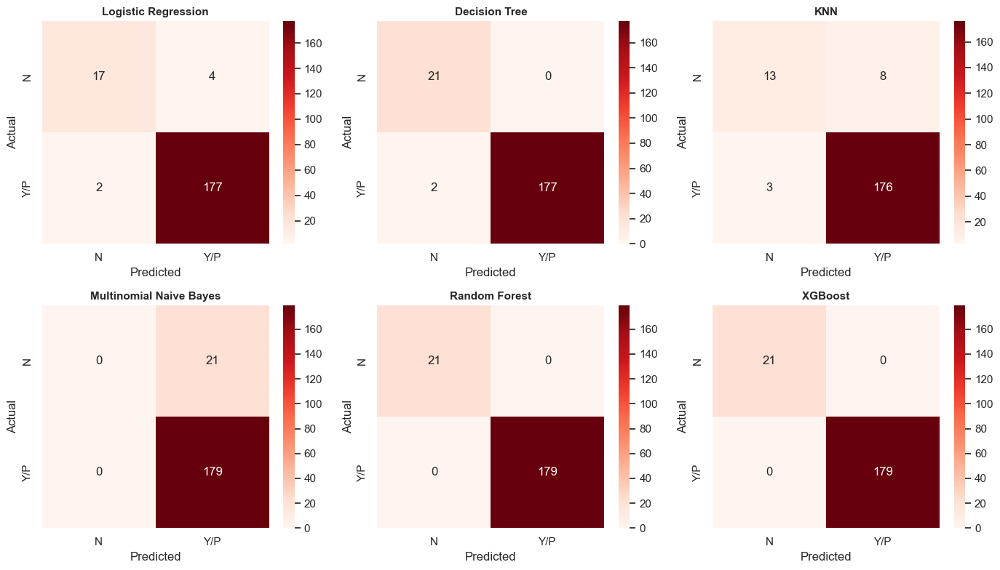

In [29]:
plot_confusion_matrices(y_test, all_predictions)

In [30]:
from sklearn.metrics import roc_curve, auc

def plot_roc_curves(y_test, probabilities_dict):
    """Plot ROC curves for all models (display only)."""
    plt.figure(figsize=(10, 8))
    colors = plt.cm.tab10(np.linspace(0, 1, len(probabilities_dict)))

    for (name, y_prob), color in zip(probabilities_dict.items(), colors):
        fpr, tpr, _ = roc_curve(y_test, y_prob)
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, color=color, lw=2,
                 label=f'{name} (AUC = {roc_auc:.3f})')

    plt.plot([0, 1], [0, 1], 'k--', lw=2, label='Random Classifier')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate', fontsize=12)
    plt.ylabel('True Positive Rate', fontsize=12)
    plt.title('ROC Curves Comparison', fontsize=14, fontweight='bold')
    plt.legend(loc='lower right', fontsize=9)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


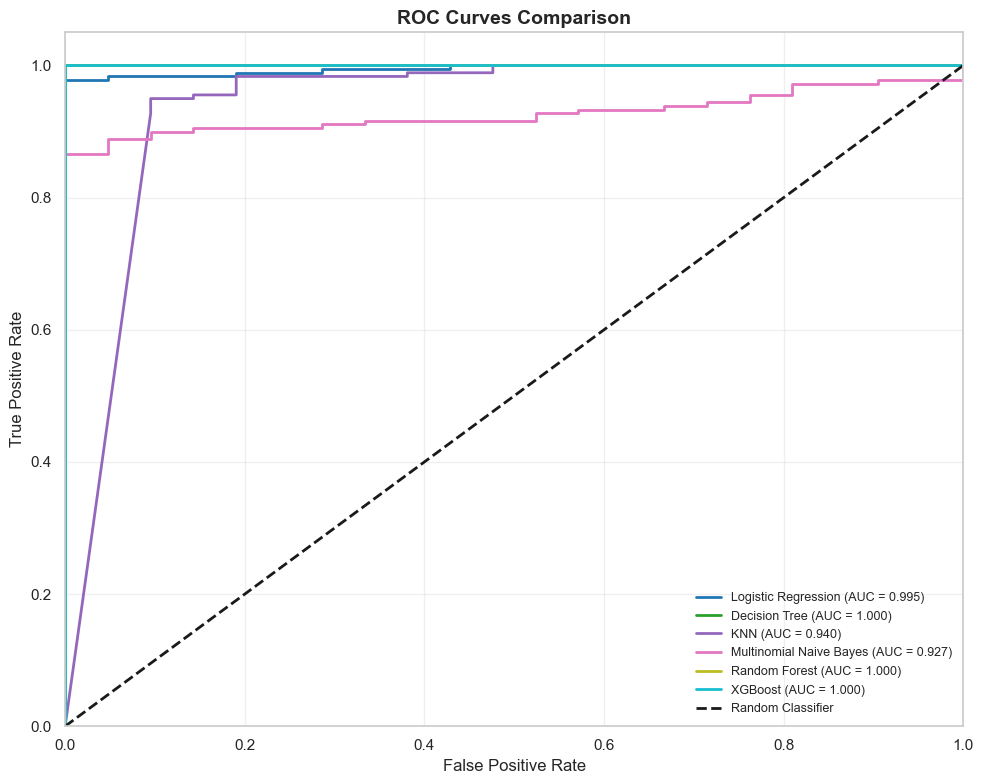

In [31]:
plot_roc_curves(y_test, all_probabilities)

In [32]:
def plot_precision_recall_curves(y_test, probabilities_dict):
    """Plot Precision-Recall curves for all models (display only)."""
    plt.figure(figsize=(10, 8))
    colors = plt.cm.tab10(np.linspace(0, 1, len(probabilities_dict)))

    for (name, y_prob), color in zip(probabilities_dict.items(), colors):
        precision, recall, _ = precision_recall_curve(y_test, y_prob)
        avg_precision = average_precision_score(y_test, y_prob)
        plt.plot(recall, precision, color=color, lw=2,
                 label=f'{name} (AP = {avg_precision:.3f})')

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Recall', fontsize=12)
    plt.ylabel('Precision', fontsize=12)
    plt.title('Precision-Recall Curves Comparison', fontsize=14, fontweight='bold')
    plt.legend(loc='lower left', fontsize=9)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


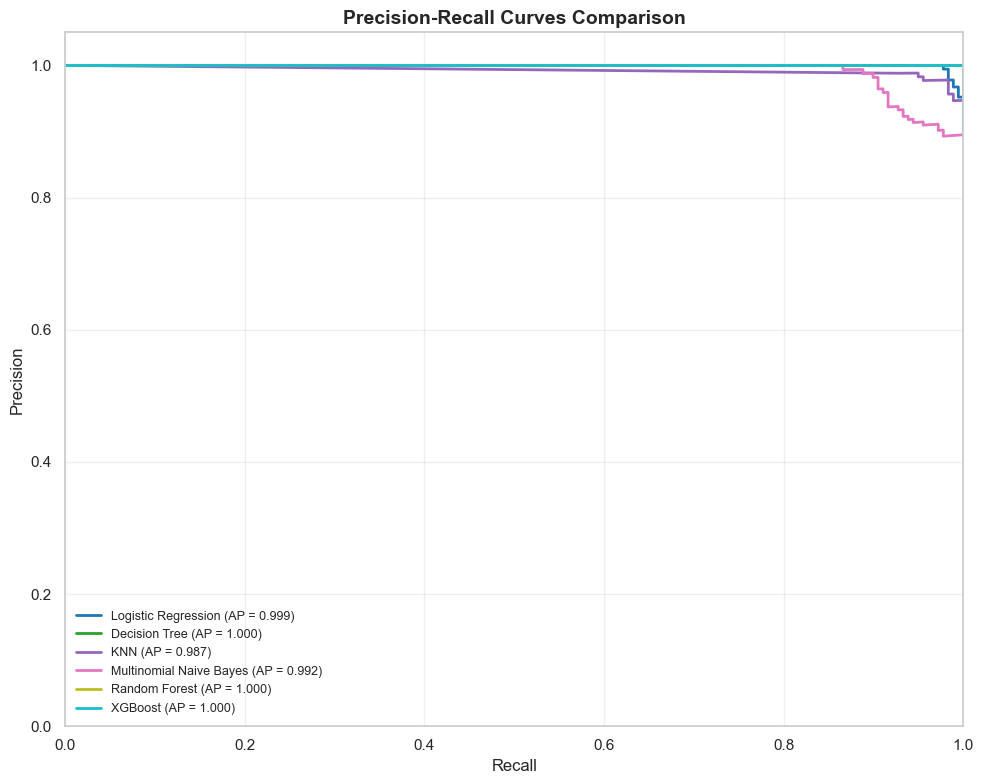

In [33]:
plot_precision_recall_curves(y_test, all_probabilities)

In [34]:
def plot_model_comparison(metrics_dict):
    """Create a bar chart comparing all models across metrics"""

    metrics_df = pd.DataFrame(metrics_dict).T

    metrics = [
        'Accuracy',
        'Precision',
        'Recall',
        'F1 Score',
        'AUC Score',
        'MCC Score'
    ]

    colors = [
        '#1f77b4',  # Blue
        '#ff7f0e',  # Orange
        '#2ca02c',  # Green
        '#9b59b6',  # Purple
        '#bcbd22',  # Yellow
        '#d62728'   # Red
    ]

    fig, axes = plt.subplots(1, len(metrics), figsize=(22, 5))

    for idx, (metric, color) in enumerate(zip(metrics, colors)):
        values = metrics_df[metric].sort_values(ascending=True)

        axes[idx].barh(
            values.index,
            values.values,
            color=color,
            alpha=0.85
        )

        axes[idx].set_xlabel(metric, fontsize=11)
        axes[idx].set_xlim([0.4, 1.0])
        axes[idx].set_title(metric, fontsize=12, fontweight='bold')

        for i, v in enumerate(values.values):
            axes[idx].text(
                v + 0.01,
                i,
                f'{v:.3f}',
                va='center',
                fontsize=9
            )

    plt.tight_layout()
    plt.show()



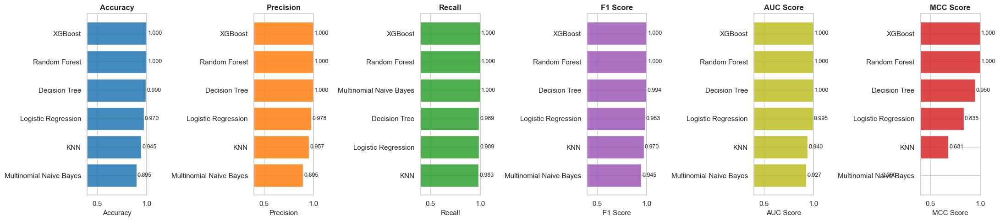

In [35]:
 plot_model_comparison(all_metrics)

In [36]:
def plot_knn_optimization(k_range, cv_scores):
    """Plot KNN optimization curve (display only)."""
    plt.figure(figsize=(10, 6))
    k_list = list(k_range)

    plt.plot(k_list, cv_scores, 'b-o', linewidth=2, markersize=6)
    plt.fill_between(k_list, cv_scores, alpha=0.2)

    best_k = k_list[np.argmax(cv_scores)]
    best_score = max(cv_scores)

    plt.axvline(x=best_k, color='r', linestyle='--',
                label=f'Optimal K = {best_k}')
    plt.scatter([best_k], [best_score],
                color='red', s=150, zorder=5, marker='*')

    plt.xlabel('Number of Neighbors (K)', fontsize=12)
    plt.ylabel('Cross-Validation F1 Score', fontsize=12)
    plt.title('KNN Hyperparameter Optimization', fontsize=14, fontweight='bold')
    plt.legend(fontsize=11)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

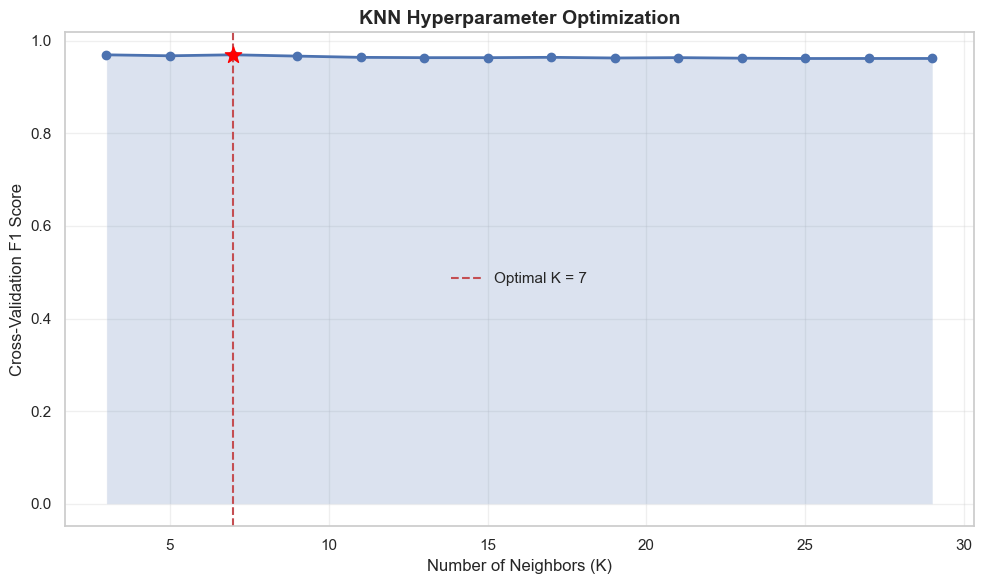

In [37]:
plot_knn_optimization(k_range, cv_scores)

In [38]:
def plot_feature_importance(model, X_train, model_name):
    import pandas as pd
    import matplotlib.pyplot as plt

    importances = model.feature_importances_
    feature_names = X_train.columns

    fi = pd.DataFrame({
        'Feature': feature_names,
        'Importance': importances
    }).sort_values('Importance', ascending=False)

    plt.figure(figsize=(8, 5))
    plt.barh(fi['Feature'][:10], fi['Importance'][:10])
    plt.gca().invert_yaxis()
    plt.title(f'{model_name} - Feature Importance')
    plt.show()


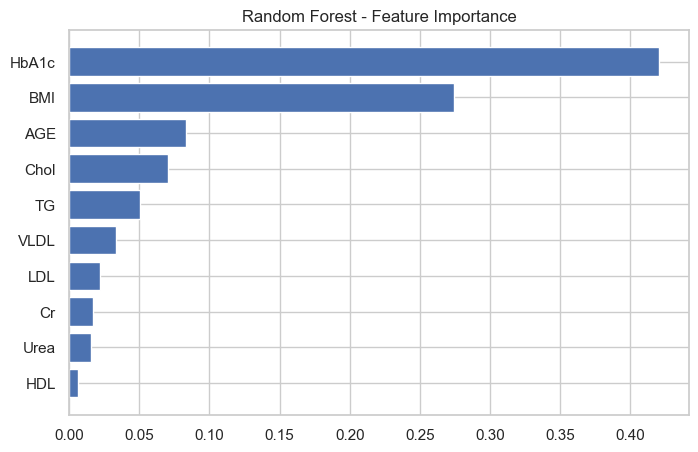

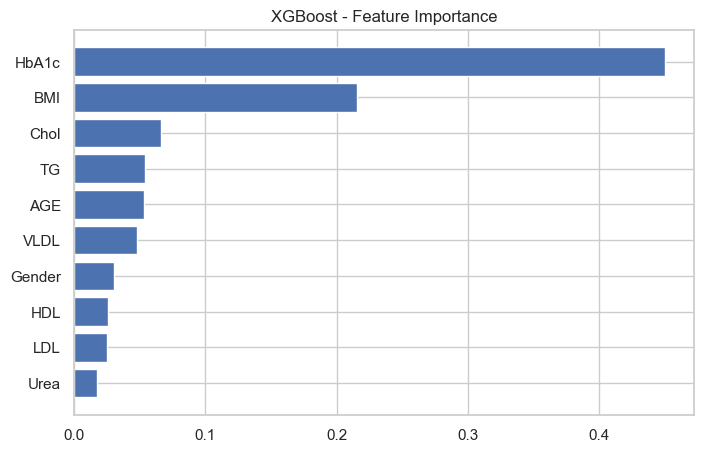

In [39]:
plot_feature_importance(rf_model, X_train, 'Random Forest')
plot_feature_importance(xgb_model, X_train, 'XGBoost')


In [40]:
print(all_metrics.keys())


dict_keys(['Logistic Regression', 'Decision Tree', 'KNN', 'Multinomial Naive Bayes', 'Random Forest', 'XGBoost'])


In [43]:
def create_summary_table(metrics_dict):
    """Create a summary table of all model metrics."""
    df = pd.DataFrame(metrics_dict).T
    df = df.round(4)
    df.index.name = 'Model'
    return df


In [45]:
    print("\n FINAL SUMMARY")
    print("="*70)

    summary_df = create_summary_table(all_metrics)
    print("\nModel Performance Summary:")
    print(summary_df.to_string())

    # Best model
    best_model = summary_df['F1 Score'].idxmax()
    print(f"\nBest Performing Model (by F1 Score): {best_model}")
    print(f"   F1 Score: {summary_df.loc[best_model, 'F1 Score']:.4f}")
    print(f"   Accuracy: {summary_df.loc[best_model, 'Accuracy']:.4f}")



 FINAL SUMMARY

Model Performance Summary:
                         Accuracy  Precision  Recall  F1 Score  AUC Score  MCC Score   CV_F1
Model                                                                                       
Logistic Regression         0.970     0.9779  0.9888    0.9833     0.9947     0.8347     NaN
Decision Tree               0.990     1.0000  0.9888    0.9944     1.0000     0.9502     NaN
KNN                         0.945     0.9565  0.9832    0.9697     0.9401     0.6806     NaN
Multinomial Naive Bayes     0.895     0.8950  1.0000    0.9446     0.9274     0.0000  0.9432
Random Forest               1.000     1.0000  1.0000    1.0000     1.0000     1.0000  0.9875
XGBoost                     1.000     1.0000  1.0000    1.0000     1.0000     1.0000  0.9881

Best Performing Model (by F1 Score): Random Forest
   F1 Score: 1.0000
   Accuracy: 1.0000


In [46]:
from joblib import dump

best_model = RandomForestClassifier(random_state=42)
best_model.fit(X_train, y_train)

dump(rf_model, "best_model.pkl")


['best_model.pkl']